# Clustering de documents

## Imports

In [1]:
import collections
import os
import string
import sys

import pandas as pd
from nltk import word_tokenize
from nltk.corpus import stopwords
from pprint import pprint
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import cosine
from collections import Counter
from wordcloud import WordCloud
import os
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from IPython.display import Image

import sys

from gensim.models.phrases import Phrases, Phraser
from gensim.models import Word2Vec

import nltk
from nltk.tokenize import wordpunct_tokenize
from unidecode import unidecode

ModuleNotFoundError: No module named 'pandas'

## Chargement et traitement des phrases du corpus

### Création d'un objet qui *streame* les lignes d'un fichier pour économiser de la RAM

In [ ]:
class MySentences(object):
    """Tokenize and Lemmatize sentences"""
    def __init__(self, filename):
        self.filename = filename

    def __iter__(self):
        for line in open(self.filename, encoding='utf-8', errors="backslashreplace"):
            yield [unidecode(w.lower()) for w in wordpunct_tokenize(line)]

In [ ]:
infile = f"../data/sents.txt"
sentences = MySentences(infile)

### Détection des bigrams

Article intéressant sur le sujet : https://towardsdatascience.com/word2vec-for-phrases-learning-embeddings-for-more-than-one-word-727b6cf723cf

In [ ]:
bigram_phrases = Phrases(sentences)

NameError: name 'Phrases' is not defined

L'object `phrases` peut être vu comme un large dictionnaire d'expressions multi-mots associées à un score, le *PMI-like scoring*. Ce dictionnaire est construit par un apprentissage sur base d'exemples.
Voir les références ci-dessous :
- https://arxiv.org/abs/1310.4546
- https://en.wikipedia.org/wiki/Pointwise_mutual_information

In [ ]:
type(bigram_phrases.vocab)

Il contient de nombreuses clés qui sont autant de termes observés dans le corpus

In [ ]:
len(bigram_phrases.vocab.keys())

Prenons une clé au hasard :

In [ ]:
key_ = list(bigram_phrases.vocab.keys())[144]
print(key_)

Le dictionnaire indique le score de cette coocurrence :

In [ ]:
bigram_phrases.vocab[key_]

Lorsque l'instance de `Phrases` a été entraînée, elle peut concaténer les bigrams dans les phrases lorsque c'est pertinent.

### Conversion des `Phrases` en objet `Phraser`

`Phraser` est un alias pour `gensim.models.phrases.FrozenPhrases`, voir ici https://radimrehurek.com/gensim/models/phrases.html.

Le `Phraser` est une version *light* du `Phrases`, plus optimale pour transformer les phrases en concaténant les bigrams.

In [ ]:
bigram_phraser = Phraser(phrases_model=bigram_phrases)

Le `Phraser` est un objet qui convertit certains unigrams d'une liste en bigrams lorsqu'ils ont été identifiés comme pertinents.

### Extraction des trigrams

Nous répétons l'opération en envoyant cette fois la liste de bigrams afin d'extraire les trigrams.

In [ ]:
trigram_phrases = Phrases(bigram_phraser[sentences])

In [ ]:
trigram_phraser = Phraser(phrases_model=trigram_phrases)

### Création d'un corpus d'unigrams, bigrams, trigrams

In [ ]:
corpus = list(trigram_phraser[bigram_phraser[sentences]])

In [ ]:
print(corpus[:100])

## Entrainement d'un modèle Word2Vec sur ce corpus

In [ ]:
%%time
model = Word2Vec(
    corpus, # On passe le corpus de ngrams que nous venons de créer
    vector_size=32, # Le nombre de dimensions dans lesquelles le contexte des mots devra être réduit, aka. vector_size
    window=5, # La taille du "contexte", ici 5 mots avant et après le mot observé
    min_count=5, # On ignore les mots qui n'apparaissent pas au moins 5 fois dans le corpus
    workers=4, # Permet de paralléliser l'entraînement du modèle en 4 threads
    epochs=5 # Nombre d'itérations du réseau de neurones sur le jeu de données pour ajuster les paramètres avec la descente de gradient, aka. epochs.
)

In [ ]:
import nltk

nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\pirar\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
data_path = "../data/txt/"

## Choisir une décennie

In [ ]:
DECADE = '1890'

## Charger tous les  fichiers de la décennie et en créer une liste de textes

In [ ]:
files = [f for f in sorted(os.listdir(data_path)) if f"_{DECADE[:-1]}" in f]

In [ ]:
# Exemple de fichiers
files[:5]

['KB_JB838_1890-01-05_01-00004.txt',
 'KB_JB838_1890-01-06_01-00003.txt',
 'KB_JB838_1890-01-08_01-00003.txt',
 'KB_JB838_1890-01-09_01-00003.txt',
 'KB_JB838_1890-01-12_01-00004.txt']

In [ ]:
texts = [open(data_path + f, "r", encoding="utf-8").read() for f in files]

In [ ]:
# Exemple de textes
texts[0][:400]

"Commencera demain lundi le 6 janvier Notre vente n’ù, lieu qu'une fois'par'ail, n 9 driétr de commun ètïï§ : ] être confondüè avec ùucune autre mise en vente. 1 Ce n’est pas une vente de soldes ou de marchandises déclassées,. priais bien une tiqüidaUqm ' Irûle de tous nos articles. ' ; iPendant la durée de la vente -toutes nos marchandnëê/sUm aucune* exception : SOfEMîmJi' VELOURS, LAINAGES, DRAPE"

## Vectoriser les documents à l'aide de TF-IDF

In [ ]:
# Création d'une fonction de pré-traitement
def preprocessing(text, stem=True):
    """ Tokenize text and remove punctuation """
    text = text.translate(string.punctuation)
    tokens = word_tokenize(text)
    return tokens

### Instancier le modèle TF-IDF avec ses arguments

In [ ]:
vectorizer = TfidfVectorizer(
    tokenizer=preprocessing,
    stop_words=stopwords.words('french'),
    max_df=0.5,
    min_df=0.1,
    lowercase=True)

### Construire la matrice de vecteurs à l'aide de la fonction `fit_transform`

In [ ]:
tfidf_vectors = vectorizer.fit_transform(texts)

c:\Users\pirar\Documents\TAC\tac\tac_venv\Lib\site-packages\sklearn\feature_extraction\text.py:525: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


In [ ]:
# Détail de la matrice
tfidf_vectors

<900x3199 sparse matrix of type '<class 'numpy.float64'>'
	with 581940 stored elements in Compressed Sparse Row format>

### Imprimer le vecteur tf-IDF du premier document

In [ ]:
pd.Series(
    tfidf_vectors[0].toarray()[0],
    index=vectorizer.get_feature_names_out()
    ).sort_values(ascending=False)

janvier      0.339744
contenant    0.321861
notaire      0.298355
1890         0.237358
are          0.229971
               ...   
emprunt      0.000000
empêcher     0.000000
en-          0.000000
endroit      0.000000
♦            0.000000
Length: 3199, dtype: float64

## Comprendre les vecteurs et leurs "distances"

In [ ]:
cosine([1, 2, 3], [1, 2, 3])

0

In [ ]:
cosine([1, 2, 3], [1, 2, 2])

0.02004211298777725

In [ ]:
cosine([1, 2, 3], [2, 2, 2])

0.07417990022744858

### Tests sur les documents

In [ ]:
tfidf_array = tfidf_vectors.toarray()

In [ ]:
# Vecteur du document 0
tfidf_array[0]

array([0.        , 0.        , 0.03966757, ..., 0.        , 0.        ,
       0.        ])

In [ ]:
# Vecteur du document 1
tfidf_array[1]

array([0.        , 0.        , 0.02106441, ..., 0.        , 0.        ,
       0.        ])

In [ ]:
cosine(tfidf_array[0], tfidf_array[1])

0.6463920765266044

## Appliquer un algorithme de clustering sur les vecteurs TF-IDF des documents

Pour en savoir plus sur le KMeans clustering :
- https://medium.com/dataseries/k-means-clustering-explained-visually-in-5-minutes-b900cc69d175

### Définir un nombre de clusters

In [ ]:
N_CLUSTERS = 3

### Instancier le modèle K-Means et ses arguments

In [ ]:
km_model = KMeans(n_clusters=N_CLUSTERS)

### Appliquer le clustering à l'aide de la fonction `fit_predict`

In [ ]:
clusters = km_model.fit_predict(tfidf_vectors)

c:\Users\pirar\Documents\TAC\tac\tac_venv\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [ ]:
clustering = collections.defaultdict(list)

for idx, label in enumerate(clusters):
    clustering[label].append(files[idx])

In [ ]:
pprint(dict(clustering))

{0: ['KB_JB838_1890-01-15_01-00001.txt',
     'KB_JB838_1890-01-16_01-00002.txt',
     'KB_JB838_1890-01-20_01-00001.txt',
     'KB_JB838_1890-01-25_01-00001.txt',
     'KB_JB838_1890-01-27_01-00002.txt',
     'KB_JB838_1890-02-05_01-00001.txt',
     'KB_JB838_1890-02-07_01-00001.txt',
     'KB_JB838_1890-02-09_01-00003.txt',
     'KB_JB838_1890-02-12_01-00002.txt',
     'KB_JB838_1890-03-04_01-00001.txt',
     'KB_JB838_1890-03-13_01-00002.txt',
     'KB_JB838_1890-03-27_01-00001.txt',
     'KB_JB838_1890-04-06_01-00002.txt',
     'KB_JB838_1890-04-13_01-00001.txt',
     'KB_JB838_1890-05-01_01-00001.txt',
     'KB_JB838_1890-05-06_01-00002.txt',
     'KB_JB838_1890-05-11_01-00001.txt',
     'KB_JB838_1890-06-06_01-00001.txt',
     'KB_JB838_1890-06-20_01-00001.txt',
     'KB_JB838_1890-06-22_01-00006.txt',
     'KB_JB838_1890-06-24_01-00001.txt',
     'KB_JB838_1890-07-02_01-00001.txt',
     'KB_JB838_1890-07-11_01-00002.txt',
     'KB_JB838_1890-08-06_01-00002.txt',
     'KB_JB838_1

## Visualiser les clusters

### Réduire les vecteurs à 2 dimensions à l'aide de l'algorithme PCA
Cette étape est nécessaire afin de visualiser les documents dans un espace 2D

https://fr.wikipedia.org/wiki/Analyse_en_composantes_principales

In [ ]:
pca = PCA(n_components=2)
reduced_vectors = pca.fit_transform(tfidf_vectors.toarray())

In [ ]:
reduced_vectors[:10]

array([[-0.07376404,  0.58397258],
       [ 0.1210826 ,  0.44897298],
       [-0.09564643,  0.19921268],
       [-0.09967026,  0.19345315],
       [-0.07116783,  0.57678447],
       [-0.21578394, -0.11584281],
       [-0.2350747 , -0.06550892],
       [-0.1814789 , -0.08390878],
       [-0.10335835,  0.17824325],
       [-0.25679124, -0.18774942]])

### Générer le plot

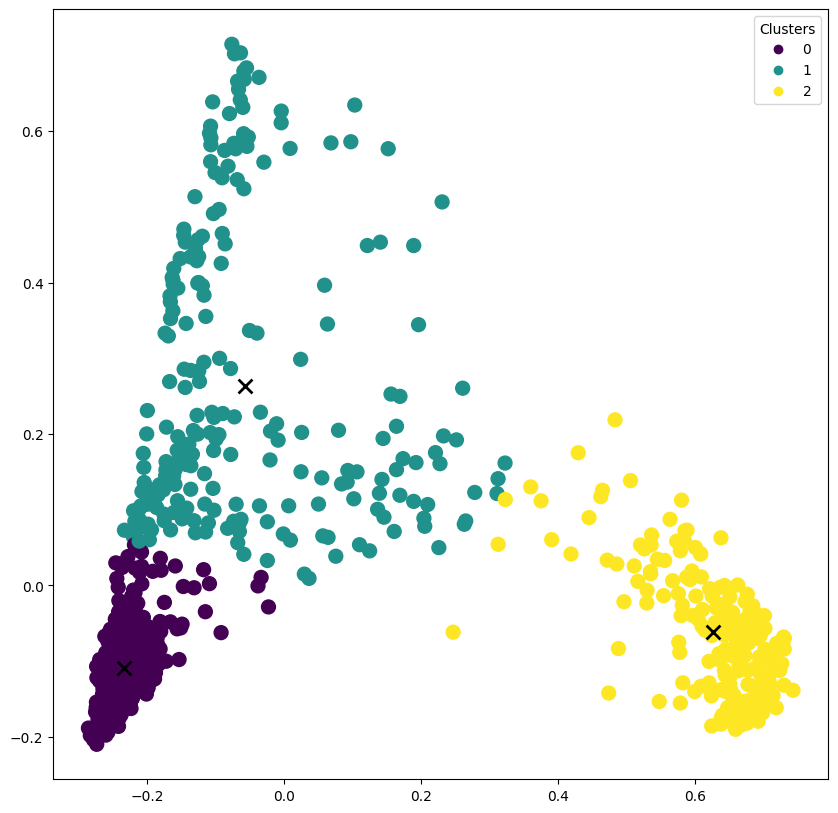

In [ ]:
x_axis = reduced_vectors[:, 0]
y_axis = reduced_vectors[:, 1]

plt.figure(figsize=(10,10))
scatter = plt.scatter(x_axis, y_axis, s=100, c=clusters)

# Ajouter les centroïdes
centroids = pca.transform(km_model.cluster_centers_)
plt.scatter(centroids[:, 0], centroids[:, 1],  marker = "x", s=100, linewidths = 2, color='black')

# Ajouter la légende
plt.legend(handles=scatter.legend_elements()[0], labels=set(clusters), title="Clusters")

In [ ]:
##Extraction des documents de chaque cluster
# Récupération des étiquettes de cluster pour chaque document
labels = km_model.labels_

# Créer un dictionnaire pour stocker les documents de chaque cluster
clusters_documents = {}
for i, label in enumerate(labels):
    if label not in clusters_documents:
        clusters_documents[label] = []
    clusters_documents[label].append(i)  # Ajouter l'index du document au cluster correspondant

for cluster_label, documents_indices in clusters_documents.items():
    print(f"Cluster {cluster_label}:")
    for doc_index in documents_indices:
        print(texts[doc_index])  # Afficher le document correspondant à l'indice
    print("\n")  # Ajouter un saut de ligne entre les clusters

Cluster 1:
Commencera demain lundi le 6 janvier Notre vente n’ù, lieu qu'une fois'par'ail, n 9 driétr de commun ètïï§ : ] être confondüè avec ùucune autre mise en vente. 1 Ce n’est pas une vente de soldes ou de marchandises déclassées,. priais bien une tiqüidaUqm ' Irûle de tous nos articles. ' ; iPendant la durée de la vente -toutes nos marchandnëê/sUm aucune* exception : SOfEMîmJi' VELOURS, LAINAGES, DRAPEWm, TISSUS POUR R ALS' ET SOIRÉES, ROBES ET-' MANTEAUX, FOURRURES, JUPES DRAPÉES-, PEIGNOIRS-, MORES D’INTÉRIEUR, CHALES,, CORSETS,-^ JUPONS- DE DESSOUS, SORTIES DE-MALETDE THÉÂTRE, : ü vendu au prix d’inventaire, c'est-à-dire avec dés différences de priât ^ grandes sur les pvix réels, , • V : ■ Le prix d’invéntaite se trouve snr chaque pièce marqué en chiffres rouges à côté du prix ■ Vmnniré, : ' AVIS. — Les magasins sont éclairés à Féktrieité. — La MalSon Hirsch et 0* n’a pas de succursale on Belgique, ; itaire De Ko, avenue de l’Astronomie, 19, vendra avec " en la salle do ventes

## Extraction de mots clés des clusters

In [ ]:
import os
import yake
from collections import Counter
from nltk.corpus import stopwords
import re

In [ ]:
# Instancier l'extracteur de mots clés
kw_extractor = yake.KeywordExtractor(lan="fr", top=50)
kw_extractor

In [ ]:
data_path = "../data/txt/"
files = os.listdir(data_path)

In [ ]:
# Parcourir chaque cluster
for cluster_label, documents_indices in clusters_documents.items():
    print(f"Mots-clés pour le cluster {cluster_label}:")
    for doc_index in documents_indices:
        text = texts[doc_index]  # Récupérer le texte du document
        keywords = kw_extractor.extract_keywords(text)  # Extraire les mots-clés du texte
        kept = []
        for kw, score in keywords:
            words = kw.split()
            if len(words) == 2:
                kept.append(kw)
        print(f"Document {doc_index} mentions these keywords: {', '.join(kept)}...")
    print("\n") 



Mots-clés pour le cluster 1:
Document 0 mentions these keywords: lieu qu'une, Commencera demain, commun ètïï, dit notaire, notaire adjugera, vente n’ù, BONNE MAISON, dee ventes, JOLIE MAISON, JUPES DRAPÉES, Adjudication préparatoire, neUirei Bruxelles...
Document 1 mentions these keywords: Maison rue, miss Sterly, grande maison, Sterly endormie, petite maison, maison rente, énormes griffes, rue Royale, louer bel, rue Thiéfry, apercevant miss...
Document 2 mentions these keywords: Manteaux Victoria, rue Haute, Jaquettes Jaquettes, rue Pachéco, Baume Pectoral, rue dés, d’agparells d'éclairage, MAISONS rue, rue Montoyer...
Document 3 mentions these keywords: rue Haute, rue Pachéco, rue Terre-Neuve, Crédit mobilier, dangereux chargement, chargement per-dessus, plus fermes, rue Royale, per-dessus bord...
Document 4 mentions these keywords: Bruxelles rue, notaire Jacobs, BONNE MAISON, dit notaire, Halles BRUXELLES, Maison Hirsch, notaire adjugera, UES MARGHAKIDÏSES, BRUXELLES PROCHAIN, Bruxe

## Regrouper les mots clés par cluster

In [ ]:
## Imports et Stopwords

In [ ]:
##Regroupement des mots clés les plus fréquents par clusters
# Charger les mots vides de la langue correspondante 
stop_words = set(stopwords.words("french"))

# Ajouter des mots à la liste des stop words
additional_stop_words = ["les", "plus", "cette", "fait", "faire", "être", "deux", "comme", "dont", "tout",
                        "ils", "elles", "il", "elle", "bien", "sans", "peut", "tous", "après", "ainsi", "donc", "cet", "sous",
                        "celle", "entre", "encore", "toutes", "pendant", "moins", "dire", "cela", "non",
                        "faut", "trois", "aussi", "dit", "avoir", "doit", "contre", "depuis", "autres",
                        "van", "het", "autre", "jusqu", "ville", "rossel", "dem", "si", "car", "autant",
                        "toute", "très", "bien", "aucun", "comme", "celui", "chaque", "plusieurs",
                        "toutes", "trop", "aucune", "parce", "quelques", "quel", "quelle", "quels",
                        "quelles", "lorsqu", "lorsque", "dès", "dans", "leurs", "peu", "toute", "toutes",
                        "DÈS", "près", "quart", "part", "ETC", "demi", "bas", "grand", "demande", "vers",
                        "avant", "vers","aussi","ans","leurs","très""les", "plus", "cette", "fait", "faire", "être", "deux", "comme", "dont", "tout",
                        "ils", "bien", "sans", "peut", "tous", "après", "ainsi", "donc", "cet", "sous",
                        "celle", "entre", "encore", "toutes", "pendant", "moins", "dire", "cela", "non",
                       "faut", "trois", "aussi", "dit", "avoir", "doit", "contre", "depuis", "autres",
                          "van", "het", "autre", "jusqu", "ville", "rossel", "dem","pers","grand","dès","jard",
                          "bas","elles","car","garni","réf","heure","quelques","plusieurs","pris","mén","serv","cert",
                           "aujourd","mme","première","trop","alors","celui" ]

# Parcours chaque cluster
for cluster_label, documents_indices in clusters_documents.items():
    print(f"Mots-clés fréquents pour le cluster {cluster_label}:")
    
    # Collecter tous les mots non vides, non numériques et ne contenant pas une seule lettre de tous les documents du cluster
    all_words = []
    for doc_index in documents_indices:
        text = texts[doc_index]
        words = re.findall(r'\b[A-Za-zÀ-ÿ]+\b', text)  # Trouver les mots alphabétiques
        # Filtrer les mots vides, les mots qui sont des chiffres et les mots d'une seule lettre
        words = [word for word in words if word.lower() not in stop_words and not word.isdigit() and len(word) > 1]
        all_words.extend(words)  # Ajouter les mots satisfaisant les critères à la liste
    
    # Calculer la fréquence des mots non vides, non numériques et ne contenant pas une seule lettre
    word_freq = Counter(all_words)
    
    # Sélectionner les mots les plus fréquents
    top_keywords = word_freq.most_common(200)
    
    # Afficher les mots-clés fréquents pour ce cluster
    for keyword, frequency in top_keywords:
        print(f"Mot-clé: {keyword}, Fréquence: {frequency}")
    print("\n")  # Saut de ligne entre les clusters

Mots-clés fréquents pour le cluster 1:
Mot-clé: rue, Fréquence: 9862
Mot-clé: fr, Fréquence: 6900
Mot-clé: do, Fréquence: 3730
Mot-clé: Bruxelles, Fréquence: 3723
Mot-clé: plus, Fréquence: 2774
Mot-clé: heures, Fréquence: 2209
Mot-clé: maison, Fréquence: 2057
Mot-clé: ans, Fréquence: 1845
Mot-clé: St, Fréquence: 1550
Mot-clé: notaire, Fréquence: 1522
Mot-clé: dé, Fréquence: 1484
Mot-clé: louer, Fréquence: 1445
Mot-clé: prix, Fréquence: 1440
Mot-clé: francs, Fréquence: 1402
Mot-clé: sans, Fréquence: 1397
Mot-clé: deux, Fréquence: 1376
Mot-clé: tout, Fréquence: 1250
Mot-clé: cours, Fréquence: 1243
Mot-clé: contenant, Fréquence: 1222
Mot-clé: fait, Fréquence: 1187
Mot-clé: tous, Fréquence: 1174
Mot-clé: bien, Fréquence: 1163
Mot-clé: cent, Fréquence: 1161
Mot-clé: très, Fréquence: 1126
Mot-clé: après, Fréquence: 1111
Mot-clé: là, Fréquence: 1060
Mot-clé: Maison, Fréquence: 1055
Mot-clé: etc, Fréquence: 1025
Mot-clé: dit, Fréquence: 995
Mot-clé: comme, Fréquence: 992
Mot-clé: Nord, Fréquen

## Wordcloud

### Créer, stocker et afficher le nuage de mots

### Entraînement d'un modèle Word2vec

## Chargement et traitement des phrases du corpus

### Création d'un objet qui *streame* les lignes d'un fichier pour économiser de la RAM

Nuage de mots pour le cluster 1:


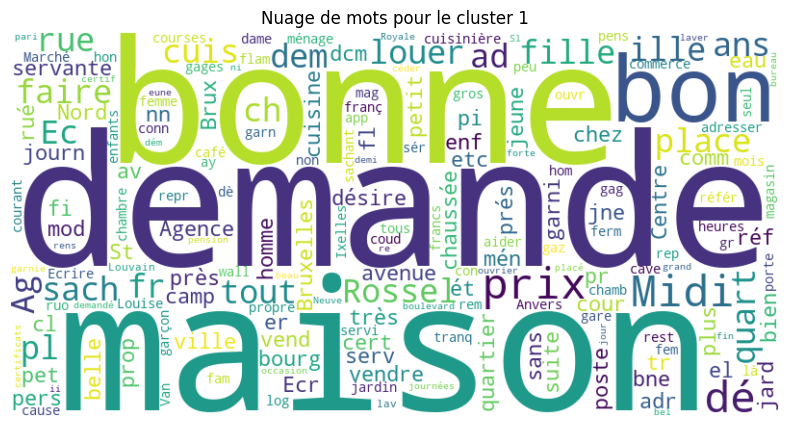

Nuage de mots pour le cluster 0:


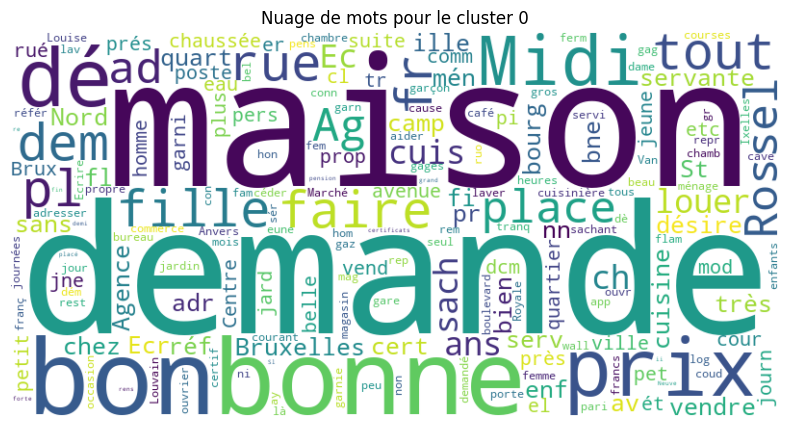

Nuage de mots pour le cluster 2:


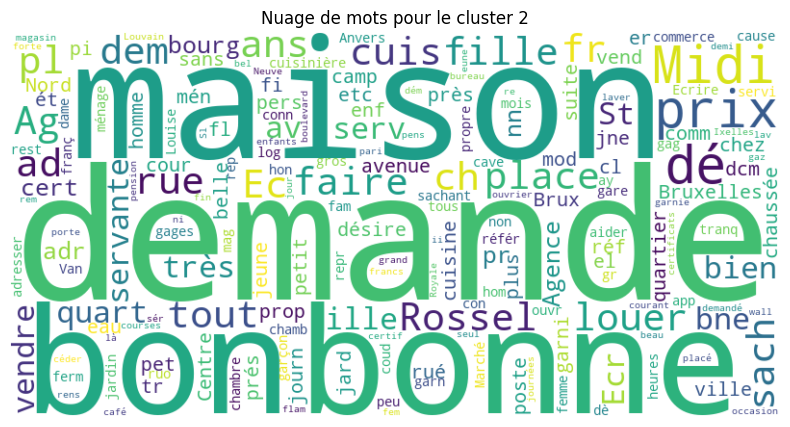

In [ ]:
# Parcours chaque cluster
for cluster_label, documents_indices in clusters_documents.items():
    print(f"Nuage de mots pour le cluster {cluster_label}:")
    
    
    # Créer une chaîne de mots pour le nuage de mots
    wordcloud_text = ' '.join([keyword for keyword, _ in top_keywords])
    
    # Créer et afficher le nuage de mots
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(wordcloud_text)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"Nuage de mots pour le cluster {cluster_label}")
    plt.show()


In [ ]:
class MySentences(object):
    """Tokenize and Lemmatize sentences"""
    def __init__(self, filename):
        self.filename = filename

    def __iter__(self):
        for line in open(self.filename, encoding='utf-8', errors="backslashreplace"):
            yield [unidecode(w.lower()) for w in wordpunct_tokenize(line)]

In [ ]:
infile = f"../data/sents.txt"
sentences = MySentences(infile)

In [ ]:
bigram_phrases = Phrases(sentences)

In [ ]:
type(bigram_phrases.vocab)

In [ ]:
len(bigram_phrases.vocab.keys())

In [ ]:
key_ = list(bigram_phrases.vocab.keys())[144]
print(key_)

In [ ]:
bigram_phrases.vocab[key_]

In [ ]:
bigram_phraser = Phraser(phrases_model=bigram_phrases)

In [ ]:
trigram_phrases = Phrases(bigram_phraser[sentences])

In [ ]:
trigram_phraser = Phraser(phrases_model=trigram_phrases)

In [ ]:
corpus = list(trigram_phraser[bigram_phraser[sentences]])

In [ ]:
print(corpus[:100])

In [ ]:
%%time
model = Word2Vec(
    corpus, # On passe le corpus de ngrams que nous venons de créer
    vector_size=32, # Le nombre de dimensions dans lesquelles le contexte des mots devra être réduit, aka. vector_size
    window=5, # La taille du "contexte", ici 5 mots avant et après le mot observé
    min_count=5, # On ignore les mots qui n'apparaissent pas au moins 5 fois dans le corpus
    workers=4, # Permet de paralléliser l'entraînement du modèle en 4 threads
    epochs=5 # Nombre d'itérations du réseau de neurones sur le jeu de données pour ajuster les paramètres avec la descente de gradient, aka. epochs.
)

In [ ]:
outfile = f"../data/newspapers.model"
model.save(outfile)


In [ ]:
model = Word2Vec.load("../data/newspapers.model")

In [ ]:
model.wv["bruxelles"]